<a 
href="https://colab.research.google.com/github/wingated/cs474_labs_f2019/blob/master/DL_Lab8.ipynb"
  target="_parent">
  <img
    src="https://colab.research.google.com/assets/colab-badge.svg"
    alt="Open In Colab"/>
</a>

# Lab 8: GANs

### Description
In this lab, we will build our very first GAN. This can be frustrating at first, but the end result is really cool. We've tried to make the steps intuitive.

Here is what you will learn:
* GANs are generative models that learn to generate data, based on a min-max/adversarial game between a Generator (G) and Discriminator (D).
* The parameters of both Generator and Discriminator are optimized with Stochastic Gradient Descent (SGD) or RMSprop or Adam
* How these concepts translate into PyTorch code for GAN optimization.

Overview of the tutorial:
1. GAN intro
2. Defining the neural networks in PyTorch, computing a forward pass
3. Training our GAN

This lab is modified from https://github.com/tomsercu/gan-tutorial-pytorch

### Deliverable
We have provided the GAN architecture for you. Your objective is to:
1. Create a DataLoader for the CelebA dataset.
2. Create a Dataset and a DataLoader for a dataset from a domain of your choice.
3. Implement the original GAN loss
4. Implement the training loop and train your GAN.

### Grading Standards
- 25% correctly implement the original GAN loss
- 25% correctly implement the training loop 
- 25% Train on CelebA and display results
- 25% Train on your own dataset and display results

(you will not be graded on quality of generated images)


### Tips:
- This lab is complex. Please read through the entire spec before diving in.
- Also, note that training on this dataset will likely take some time. Please make sure you start early enough to run the training long enough!
- Expected values: Discriminator Loss will hover around ~ 0.5, Generator Loss should hover around ~ 5.5. You should see discernible results within 1 epoch (~20-30 minutes of training on Colab).

# Some cool demos:
* Progress over the last 5 years, from [Ian Goodfellow tweet](https://twitter.com/goodfellow_ian/status/1084973596236144640)

![tweet image](https://github.com/tomsercu/gan-tutorial-pytorch/blob/master/figs/goodfellow_tweet.jpg?raw=1)

* CycleGAN translating horses into zebras: https://www.youtube.com/watch?v=9reHvktowLY
* CycleGAN teaser: ![cyclegan teaser image](https://github.com/tomsercu/gan-tutorial-pytorch/blob/master/figs/cyclegan_teaser_high_res.jpg?raw=1)
* High resolution faces with StyleGAN https://www.youtube.com/watch?v=kSLJriaOumA
* https://ganbreeder.app web-interface to create images based on [BigGan](https://arxiv.org/abs/1809.11096)


# 1. GAN first introduction
[GAN picture](figs/gan_xavigiro.png)

<img src="https://github.com/tomsercu/gan-tutorial-pytorch/blob/master/figs/gan_xavigiro.png?raw=1" alt="GAN picture" style="width: 700px;"/>

GANs are a class of unsupervised generative models which implicitly model the data density.

The basic setup is pictured above. There are two "competing" neural networks:
* The Generator wants to learn to generate realistic images that are indistinguishable from the real data. 
    - *input*: Gaussian noise random sample. *output*: a (higher dimensional) datapoint
* The Discriminator wants to tell the real & fake images apart.
    - *input*: datapoint/image, *output*: probability assigned to datapoint being real. Think binary classifier.
* The typical analogy: the generator is like a counterfeiter trying to look like real, the discriminator is the police trying to tell counterfeits from the real work.
* The key novelty of GANs is to pass the error signal (gradients) from the discriminator to the generator: the generator neural network uses the information from the competing discriminator neural network to know how to produce more realistic output.

Let's start with defining the generator G and discriminator D in pytorch.

# 2. Define the Generator and Discriminator

In [ ]:
import sys
import torch
import torch.nn as nn
import torchvision.datasets
import torchvision.transforms as transforms
import torch.nn.functional as F
import torchvision.utils as vutils

%matplotlib inline
import matplotlib.pyplot as plt
import os, time

import torch.optim as optim
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
from tqdm import tqdm

# You can use whatever display function you want. This is a really simple one that makes decent visualizations
def show_imgs(x, new_fig=True):
    grid = vutils.make_grid(x.detach().cpu(), nrow=8, normalize=True, pad_value=0.3)
    grid = grid.transpose(0,2).transpose(0,1) # channels as last dimension
    if new_fig:
        plt.figure()
    plt.imshow(grid.numpy())

## Defining the neural networks

In [ ]:
class Generator(nn.Module):
    # initializers
    def __init__(self, d=128):
        super().__init__()
        self.deconv1 = nn.ConvTranspose2d(100, d*8, 4, 1, 0)
        self.deconv1_bn = nn.BatchNorm2d(d*8)
        self.deconv2 = nn.ConvTranspose2d(d*8, d*4, 4, 2, 1)
        self.deconv2_bn = nn.BatchNorm2d(d*4)
        self.deconv3 = nn.ConvTranspose2d(d*4, d*2, 4, 2, 1)
        self.deconv3_bn = nn.BatchNorm2d(d*2)
        self.deconv4 = nn.ConvTranspose2d(d*2, d, 4, 2, 1)
        self.deconv4_bn = nn.BatchNorm2d(d)
        self.deconv5 = nn.ConvTranspose2d(d, 3, 4, 2, 1)

    # forward method
    def forward(self, x):
        x = F.relu(self.deconv1_bn(self.deconv1(x)))
        x = F.relu(self.deconv2_bn(self.deconv2(x)))
        x = F.relu(self.deconv3_bn(self.deconv3(x)))
        x = F.relu(self.deconv4_bn(self.deconv4(x)))
        x = torch.tanh(self.deconv5(x))

        return x

In [ ]:
class Discriminator(nn.Module):
    # initializers
    def __init__(self, d=128):
        super().__init__()
        self.conv1 = nn.Conv2d(3, d, 4, 2, 1)
        self.conv2 = nn.Conv2d(d, d*2, 4, 2, 1)
        self.conv2_bn = nn.BatchNorm2d(d*2)
        self.conv3 = nn.Conv2d(d*2, d*4, 4, 2, 1)
        self.conv3_bn = nn.BatchNorm2d(d*4)
        self.conv4 = nn.Conv2d(d*4, d*8, 4, 2, 1)
        self.conv4_bn = nn.BatchNorm2d(d*8)
        self.conv5 = nn.Conv2d(d*8, 1, 4, 1, 0)

    # forward method
    def forward(self, x):
        x = F.leaky_relu(self.conv1(x), 0.2)
        x = F.leaky_relu(self.conv2_bn(self.conv2(x)), 0.2)
        x = F.leaky_relu(self.conv3_bn(self.conv3(x)), 0.2)
        x = F.leaky_relu(self.conv4_bn(self.conv4(x)), 0.2)
        x = torch.sigmoid(self.conv5(x))

        return x

In [ ]:
#####
# Instantiate a Generator and Discriminator according to their class definition.
#####
D = Discriminator()
G = Generator()
print(D)
print(G)

Discriminator(
  (conv1): Conv2d(3, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv2): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv2_bn): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv3): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv3_bn): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv4): Conv2d(512, 1024, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv4_bn): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv5): Conv2d(1024, 1, kernel_size=(4, 4), stride=(1, 1))
)
Generator(
  (deconv1): ConvTranspose2d(100, 1024, kernel_size=(4, 4), stride=(1, 1))
  (deconv1_bn): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (deconv2): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (deconv2_bn): BatchNorm2d(512, eps=1e-05, m

## Testing the neural networks (forward pass)

In [ ]:
# <   64x64 doesn't work.
# ==  64x64 gives one element per batch.
# 

s_ = 80
samples = torch.randn(1, 3, s_, s_) # batch size x channels x width x height
D(samples)

tensor([[[[0.6190, 0.4252],
          [0.5232, 0.4501]]]], grad_fn=<SigmoidBackward>)

Things to try:
* What happens if you change the number of samples in a batch?
  * The number of outputs will equal the number of batches.
* What happens if you change the width/height of the input?
  * The dimensionality of the output increase from 1 to a higher number. Setting the height/width to 100 gives a 3x3 output on the last two channels.
* What are the weights of the discriminator? You can get an iterator over them with `.parameters()` and `.named_parameters()`
  * Outputs are below

In [ ]:
for name, p in D.named_parameters():
    print(name, p.shape)

conv1.weight torch.Size([128, 3, 4, 4])
conv1.bias torch.Size([128])
conv2.weight torch.Size([256, 128, 4, 4])
conv2.bias torch.Size([256])
conv2_bn.weight torch.Size([256])
conv2_bn.bias torch.Size([256])
conv3.weight torch.Size([512, 256, 4, 4])
conv3.bias torch.Size([512])
conv3_bn.weight torch.Size([512])
conv3_bn.bias torch.Size([512])
conv4.weight torch.Size([1024, 512, 4, 4])
conv4.bias torch.Size([1024])
conv4_bn.weight torch.Size([1024])
conv4_bn.bias torch.Size([1024])
conv5.weight torch.Size([1, 1024, 4, 4])
conv5.bias torch.Size([1])


We will think of the concatentation of all these discriminator weights in one big vector as $\theta_D$.

Similarly we name the concatentation of all the generator weights in one big vector $\theta_G$.

In [ ]:
for name, p in G.named_parameters():
    print(name, p.shape)

deconv1.weight torch.Size([100, 1024, 4, 4])
deconv1.bias torch.Size([1024])
deconv1_bn.weight torch.Size([1024])
deconv1_bn.bias torch.Size([1024])
deconv2.weight torch.Size([1024, 512, 4, 4])
deconv2.bias torch.Size([512])
deconv2_bn.weight torch.Size([512])
deconv2_bn.bias torch.Size([512])
deconv3.weight torch.Size([512, 256, 4, 4])
deconv3.bias torch.Size([256])
deconv3_bn.weight torch.Size([256])
deconv3_bn.bias torch.Size([256])
deconv4.weight torch.Size([256, 128, 4, 4])
deconv4.bias torch.Size([128])
deconv4_bn.weight torch.Size([128])
deconv4_bn.bias torch.Size([128])
deconv5.weight torch.Size([128, 3, 4, 4])
deconv5.bias torch.Size([3])


In [ ]:
# A small batch of 2 samples, random noise.
z = torch.randn(2, 100).view(-1,100,1,1)
x_gen = G(z)

# NOTE: Notice that the generated value is a batch of 2 images.
x_gen.shape

torch.Size([2, 3, 64, 64])

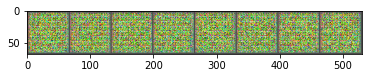

In [ ]:
z = torch.randn(8, 100).view(-1,100,1,1).cuda()
G = G.cuda()
show_imgs(G(z))

In traditional deep learning, you measure performance by looking at the loss value. In GANs, this does not work well because we are performing a Min-Max and the loss values may not be intuitively lower when the network is doing well. 

So, performance must be measured qualitatively, by looking at images. Therefore, you can sample random $z$ vectors every pass through the network to see how "novel" the generation is becoming. And you can also sample a single $z$ vector that is passed through the network every time to see how a single example progresses during training. 

In [ ]:
fixed_z_ = torch.randn((5 * 5, 100)).view(-1, 100, 1, 1)    # fixed noise
fixed_z_ = fixed_z_.cuda()

## Loading the data and computing forward pass

In [ ]:
batch_size = 128
lr = 0.0002
train_epoch = 3

img_size = 64

# Download the data, and change the filepath.
if not os.path.exists('./celeba'):
  !wget -O ./celeba.zip "https://s3-us-west-1.amazonaws.com/udacity-dlnfd/datasets/celeba.zip"
  !unzip ./celeba.zip -d ./celeba

# Possible sources for celeba: https://s3-us-west-1.amazonaws.com/udacity-dlnfd/datasets/celeba.zip
celeba_dataset = datasets.ImageFolder(
    root='./celeba', 
    transform=transforms.Compose([
        transforms.Resize(img_size),
        transforms.CenterCrop(img_size),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
    ]),
)

# Create the dataloader.
celeba_train_loader = DataLoader(
  celeba_dataset, 
  batch_size=batch_size, 
  pin_memory=True
)

Dataset and DataLoader are abstractions to help us iterate over the data in random order.

Let's look at a sample:

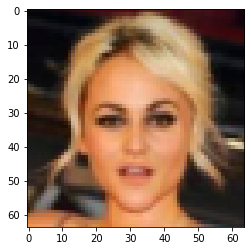

In [ ]:
ix=140
x, _ = celeba_dataset[ix]
show_imgs(x)

Feed the image into the discriminator; the output will be the probability the (untrained) discriminator assigns to this sample being real.

In [ ]:
# for one image:
Dscore = D(x.unsqueeze(0))
Dscore

tensor([[[[0.4634]]]], grad_fn=<SigmoidBackward>)

In [ ]:
# How you can get a batch of images from the dataloader:
xbatch, _ = iter(celeba_train_loader).next()
xbatch.shape
D(xbatch)
D(xbatch).shape

torch.Size([128, 1, 1, 1])

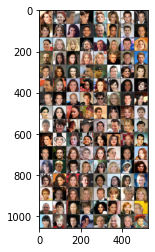

In [ ]:
show_imgs(xbatch)

# 3. Now to train your GAN

We introduced and defined the generator G, the discriminator D, and the dataloader which will give us minibatches of real data. 

To recap the basic idea of the min-max / adversarial game:
* The Generator and Discriminator have competing objectives, they are "adversaries".
* The Discriminator wants to assign high probability to real images and low probability to generated (fake) images
* The Generator wants its generated images to look real, so wants to modify its outputs to get high scores from the Discriminator
* We will optimize both alternatingly, with SGD steps (as before): optimize $\theta_D$ the weights of $D(x, \theta_D)$, and  $\theta_G$ the weights of $G(z, \theta_G)$.
* Final goal of the whole min-max game is for the Generator to match the data distribution: $p_G(x) \approx p_{data}(x)$.


Now what are the objective functions for each of them? As mentioned in the introduction, the objective for the discriminator is to classify the real images as real, so $D(x) = 1$, and the fake images as fake, so $D(G(z))=0$.
This is a typical binary classification problem which calls for the binary cross-entropy (BCE) loss, which encourages exactly this solution.

For G we just try to minimize the same loss that D maximizes. See how G appears inside D? This shows how the output of the generator G is passed into the Discriminator to compute the loss.


This is the optimization problem:

$$
\min _{G} \max _{D} V(D, G)=\mathbb{E}_{\boldsymbol{x} \sim p_{\text { data }}(\boldsymbol{x})}[\log D(\boldsymbol{x})]+\mathbb{E}_{\boldsymbol{z} \sim p_{\boldsymbol{z}}(\boldsymbol{z})}[\log (1-D(G(\boldsymbol{z})))]
$$

We will do a single SGD step alternatingly to maximize D, then minimize G.
In fact for G we use a modified (non-saturing) loss $-\log D(G(z))$. Different modifications of the loss and the relation to the distance between distributions $p_{data}$ and $p_{G}$ became a topic of research over the last years.

BCE takes care of the log, you won't manually compute any Log values


In [ ]:

def train(train_loader):
    num_iter = 0
    
    for epoch in range(train_epoch):
        D_losses = []
        G_losses = []
        epoch_start_time = time.time()
        for x_, _ in tqdm(train_loader):
            # train discriminator D
            D.zero_grad()

            mini_batch = x_.size()[0]

            #####
            # create y_real_ and y_fake_ tensors you will use in your BCE loss to push probabilities 
            # in the proper direction
            # y_real_ will be a tensor of all ones, because you want whatever is outputted by the generator
            # to be more likely to be real and you want the discriminator to recognize real images
            # y_fake_ then is a tensor of all zeros, because you want the discriminator to recognize fake images
            #####
            # TODO: Fix
            # print(f'x_.size()={x_.size()}')
            y_real_ = torch.ones((mini_batch))
            y_fake_ = torch.zeros((mini_batch))
            x_, y_real_, y_fake_ = x_.cuda(), y_real_.cuda(), y_fake_.cuda()
            # print(f'mini_batch_Size={mini_batch}')

            #####
            # pass x_ through the discriminator to get D_result
            # you will need to squeeze() the output before passing it to BCE_loss
            # compute D_real_loss using BCE_loss and the proper y tensor from above
            # you are trying to make the discriminator recognize the real image properly
            #####
            # TODO: Fix
            D_result = D(x_)
            D_result = D_result.squeeze()
            # print(f'D_result.size()={D_result.size()}')
            # Try to recognize real images properly.
            D_real_loss = BCE_loss(D_result, y_real_)

            #####
            # sample a z vector (remember to view(-1,100,1,1))
            # pass the z vector to the GPU and through your generator
            # this will create G_result
            #####
            # A small batch of 2 samples, random noise.
            # z = torch.randn(2, 100).view(-1,100,1,1)
            Z = torch.randn(mini_batch, 100).view(-1, 100, 1, 1).cuda()
            G_result = G(Z)

            #####
            # pass G_result through the discriminator and get D_result
            # you will need to squeeze() the output of the discriminator
            # compute D_fake_loss for the generated images by using BCE_loss and the proper y_tensor
            # you are trying to make the discriminator recognize the fake image properly
            #####
            D_result = D(G_result)
            D_result = D_result.squeeze()
            D_fake_loss = BCE_loss(D_result, y_fake_)

            #####
            # sum D_real_loss and D_fake_loss to get D_train_loss
            # compute the gradients
            # step the optimizer
            #####
            # print(f'D_real_loss={D_real_loss}, D_fake_loss={D_fake_loss}')
            D_train_loss = D_real_loss + D_fake_loss
            D_losses.append(D_train_loss.item())
            D_train_loss.backward()
            D_optimizer.step()

            # Train generator G
            G.zero_grad()

            #####
            # sample a z vector (viewed properly) and pass it to the GPU and through the generator
            # compute the discriminated value of the generated image, properly squeezing the output
            # get G_train_loss by using BCE_loss and the proper y_tensor
            # you are trying to make the generator generate real images
            # compute the gradients
            # step the optimizer
            #####
            Z = torch.randn(mini_batch, 100).view(-1, 100, 1, 1).cuda()
            G_result = G(Z)
            discriminated = D(G_result).squeeze()

            # Compute grads and step
            G_train_loss = BCE_loss(discriminated, y_real_)
            G_train_loss.backward()
            G_optimizer.step()
            G_losses.append(G_train_loss.item())

            num_iter += 1

        # generate a fixed_z_ image and save
        x_gen = G(fixed_z_)
        collect_x_gen.append(x_gen.detach().clone())
        epoch_end_time = time.time()
        per_epoch_ptime = epoch_end_time - epoch_start_time

        # print out statistics
        print('[%d/%d] - ptime: %.2f, loss_d: %.3f, loss_g: %.3f' % ((epoch + 1), train_epoch, 
                                                                     per_epoch_ptime, torch.mean(torch.FloatTensor(D_losses)),
                                                                     torch.mean(torch.FloatTensor(G_losses))))
        show_imgs(G_result[:4])

  0%|          | 0/1583 [00:00<?, ?it/s]

[1/3] - ptime: 3115.87, loss_d: 0.888, loss_g: 3.861


  0%|          | 0/1583 [00:00<?, ?it/s]

[2/3] - ptime: 3137.08, loss_d: 0.551, loss_g: 4.186


100%|██████████| 1583/1583 [52:18<00:00,  1.98s/it]


[3/3] - ptime: 3138.42, loss_d: 0.433, loss_g: 4.542


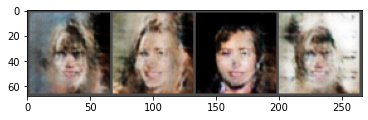

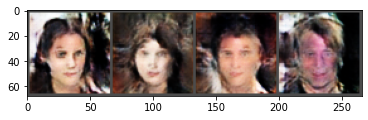

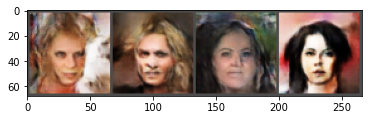

In [ ]:
G = Generator(128)
D = Discriminator(128)
G = G.cuda()
D = D.cuda()

# Binary Cross Entropy loss
BCE_loss = nn.BCELoss()

# Adam optimizer
G_optimizer = optim.Adam(G.parameters(), lr=lr, betas=(0.5, 0.999))
D_optimizer = optim.Adam(D.parameters(), lr=lr, betas=(0.5, 0.999))
# Train GAN
collect_x_gen = []
train(celeba_train_loader)

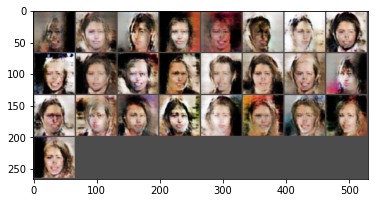

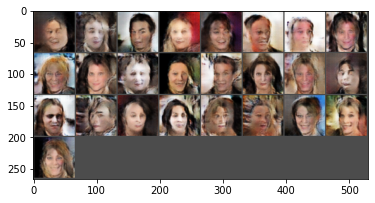

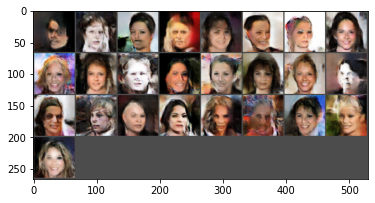

In [ ]:
for x_gen in collect_x_gen:
    show_imgs(x_gen)

Now generate something with your own dataset! (Fashion, Mnist, Coco, Bedrooms, Pokemon)

In [ ]:
# NOTE: Make sure the batch size is divisible by batch_size
# Create a Dataloader for your own dataset
# Load images, make divisible by batch_size
# assert(len(images) % batch_size == 0)
!pip install -q kaggle
from google.colab import files

batch_size = 32
lr = 0.0002
train_epoch = 100
img_size = 64

# your_train_loader = None
if not os.path.exists('./mygan'):
  files.upload()
  !mkdir ~/.kaggle
  !cp kaggle.json ~/.kaggle/
  !chmod 600 ~/.kaggle/kaggle.json
  !kaggle datasets download -d jerimee/goblin-portraits
  !ls /content
  !unzip /content/goblin-portraits.zip -d ./mygan
  !ls ./mygan

# !ls ./mygan/images
while True:
  my_dataset = datasets.ImageFolder(
      root='./mygan', 
      transform=transforms.Compose([
          transforms.Resize(img_size),
          transforms.CenterCrop(img_size),
          transforms.ToTensor(),
          transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
      ]),
  )

  if len(my_dataset) % batch_size == 0:
    print('Dataset is now divisible by batch size.')
    break

  f2remove = os.listdir('./mygan/images')[0]
  f2remove_path = f'./mygan/images/{f2remove}'
  print(f'Deleting a file: {f2remove_path}')
  os.remove(f2remove_path)

print(f'Image count: {len(my_dataset)}')

# Create the dataloader.
your_train_loader = DataLoader(
  my_dataset, 
  batch_size=batch_size, 
  pin_memory=True
)

Dataset is now divisible by batch size.
Image count: 640



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[1/100] - ptime: 18.60, loss_d: 0.974, loss_g: 14.241



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[2/100] - ptime: 18.58, loss_d: 0.308, loss_g: 16.920



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[3/100] - ptime: 18.58, loss_d: 0.238, loss_g: 17.860



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[4/100] - ptime: 18.57, loss_d: 0.953, loss_g: 15.640



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]


[5/100] - ptime: 18.51, loss_d: 1.221, loss_g: 6.058



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[6/100] - ptime: 18.57, loss_d: 0.616, loss_g: 3.982



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[7/100] - ptime: 18.49, loss_d: 0.864, loss_g: 3.451



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[8/100] - ptime: 18.49, loss_d: 0.684, loss_g: 3.803



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[9/100] - ptime: 18.50, loss_d: 0.920, loss_g: 3.872



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[10/100] - ptime: 18.50, loss_d: 0.944, loss_g: 3.837



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[11/100] - ptime: 18.50, loss_d: 1.094, loss_g: 2.799



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[12/100] - ptime: 18.55, loss_d: 0.954, loss_g: 2.934



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[13/100] - ptime: 18.50, loss_d: 0.841, loss_g: 3.395



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[14/100] - ptime: 18.53, loss_d: 1.153, loss_g: 3.600



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[15/100] - ptime: 18.57, loss_d: 0.839, loss_g: 3.013



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[16/100] - ptime: 18.51, loss_d: 1.009, loss_g: 3.462



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[17/100] - ptime: 18.49, loss_d: 0.915, loss_g: 3.320



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[18/100] - ptime: 18.50, loss_d: 1.082, loss_g: 3.621



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[19/100] - ptime: 18.54, loss_d: 0.744, loss_g: 2.799



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[20/100] - ptime: 18.51, loss_d: 0.858, loss_g: 3.481



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

  0%|          | 0/20 [00:00<?, ?it/s]

[21/100] - ptime: 18.54, loss_d: 0.849, loss_g: 3.097



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[22/100] - ptime: 18.59, loss_d: 0.848, loss_g: 3.113



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[23/100] - ptime: 18.56, loss_d: 0.867, loss_g: 3.640



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[24/100] - ptime: 18.57, loss_d: 0.687, loss_g: 3.240



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[25/100] - ptime: 18.61, loss_d: 1.114, loss_g: 3.122



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[26/100] - ptime: 18.58, loss_d: 0.737, loss_g: 3.204



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[27/100] - ptime: 18.61, loss_d: 0.880, loss_g: 3.506



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[28/100] - ptime: 18.53, loss_d: 0.938, loss_g: 3.645



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[29/100] - ptime: 18.55, loss_d: 0.858, loss_g: 3.266



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[30/100] - ptime: 18.54, loss_d: 0.833, loss_g: 3.464



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[31/100] - ptime: 18.48, loss_d: 0.898, loss_g: 3.291



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[32/100] - ptime: 18.58, loss_d: 1.014, loss_g: 3.392



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[33/100] - ptime: 18.49, loss_d: 0.926, loss_g: 3.438



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[34/100] - ptime: 18.53, loss_d: 0.649, loss_g: 3.199



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[35/100] - ptime: 18.56, loss_d: 1.049, loss_g: 3.805



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[36/100] - ptime: 18.58, loss_d: 0.681, loss_g: 3.023



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[37/100] - ptime: 18.52, loss_d: 0.898, loss_g: 3.995



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[38/100] - ptime: 18.60, loss_d: 0.721, loss_g: 3.607



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[39/100] - ptime: 18.54, loss_d: 0.852, loss_g: 3.821



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[40/100] - ptime: 18.54, loss_d: 0.594, loss_g: 3.812



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[41/100] - ptime: 18.58, loss_d: 0.718, loss_g: 4.186



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[42/100] - ptime: 18.59, loss_d: 0.787, loss_g: 3.543



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[43/100] - ptime: 18.60, loss_d: 0.717, loss_g: 4.059



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[44/100] - ptime: 18.60, loss_d: 0.720, loss_g: 3.805



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[45/100] - ptime: 18.57, loss_d: 0.803, loss_g: 4.437



100%|██████████| 20/20 [00:18<00:00,  1.07it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[46/100] - ptime: 18.64, loss_d: 0.719, loss_g: 3.684



100%|██████████| 20/20 [00:18<00:00,  1.07it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[47/100] - ptime: 18.62, loss_d: 0.676, loss_g: 4.181



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[48/100] - ptime: 18.58, loss_d: 0.523, loss_g: 3.931



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[49/100] - ptime: 18.59, loss_d: 0.761, loss_g: 4.060



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[50/100] - ptime: 18.53, loss_d: 0.546, loss_g: 4.462



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[51/100] - ptime: 18.60, loss_d: 0.763, loss_g: 4.468



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[52/100] - ptime: 18.59, loss_d: 0.480, loss_g: 3.554



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[53/100] - ptime: 18.59, loss_d: 0.832, loss_g: 4.314



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[54/100] - ptime: 18.56, loss_d: 0.597, loss_g: 3.992



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[55/100] - ptime: 18.58, loss_d: 0.594, loss_g: 4.395



100%|██████████| 20/20 [00:18<00:00,  1.07it/s]


[56/100] - ptime: 18.64, loss_d: 0.644, loss_g: 4.240



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[57/100] - ptime: 18.57, loss_d: 0.624, loss_g: 4.045



100%|██████████| 20/20 [00:18<00:00,  1.07it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[58/100] - ptime: 18.63, loss_d: 0.304, loss_g: 4.357



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[59/100] - ptime: 18.56, loss_d: 0.832, loss_g: 3.961



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[60/100] - ptime: 18.59, loss_d: 0.408, loss_g: 4.356



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[61/100] - ptime: 18.56, loss_d: 0.586, loss_g: 4.707



100%|██████████| 20/20 [00:18<00:00,  1.07it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[62/100] - ptime: 18.63, loss_d: 0.698, loss_g: 4.120



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[63/100] - ptime: 18.60, loss_d: 0.434, loss_g: 4.211



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[64/100] - ptime: 18.50, loss_d: 0.350, loss_g: 4.644



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[65/100] - ptime: 18.60, loss_d: 0.813, loss_g: 4.489



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[66/100] - ptime: 18.59, loss_d: 0.363, loss_g: 4.720



100%|██████████| 20/20 [00:18<00:00,  1.07it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[67/100] - ptime: 18.64, loss_d: 1.077, loss_g: 4.300



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[68/100] - ptime: 18.54, loss_d: 0.445, loss_g: 4.103



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[69/100] - ptime: 18.54, loss_d: 0.513, loss_g: 4.338



100%|██████████| 20/20 [00:18<00:00,  1.07it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[70/100] - ptime: 18.63, loss_d: 0.277, loss_g: 4.362



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[71/100] - ptime: 18.54, loss_d: 0.656, loss_g: 4.955



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[72/100] - ptime: 18.54, loss_d: 0.522, loss_g: 4.387



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[73/100] - ptime: 18.61, loss_d: 0.631, loss_g: 4.288



100%|██████████| 20/20 [00:18<00:00,  1.07it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[74/100] - ptime: 18.65, loss_d: 0.305, loss_g: 4.069



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[75/100] - ptime: 18.58, loss_d: 0.240, loss_g: 5.108



100%|██████████| 20/20 [00:18<00:00,  1.07it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[76/100] - ptime: 18.65, loss_d: 0.709, loss_g: 4.629



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[77/100] - ptime: 18.59, loss_d: 0.337, loss_g: 4.819



100%|██████████| 20/20 [00:18<00:00,  1.07it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[78/100] - ptime: 18.62, loss_d: 0.318, loss_g: 4.486



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[79/100] - ptime: 18.59, loss_d: 0.615, loss_g: 4.668



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[80/100] - ptime: 18.61, loss_d: 0.233, loss_g: 4.790



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[81/100] - ptime: 18.60, loss_d: 0.579, loss_g: 5.084



100%|██████████| 20/20 [00:18<00:00,  1.07it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[82/100] - ptime: 18.64, loss_d: 0.480, loss_g: 4.462



100%|██████████| 20/20 [00:18<00:00,  1.08it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[83/100] - ptime: 18.59, loss_d: 0.491, loss_g: 5.066



100%|██████████| 20/20 [00:18<00:00,  1.07it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[84/100] - ptime: 18.66, loss_d: 0.392, loss_g: 4.574



100%|██████████| 20/20 [00:18<00:00,  1.07it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[85/100] - ptime: 18.64, loss_d: 0.276, loss_g: 4.860



100%|██████████| 20/20 [00:19<00:00,  1.05it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[86/100] - ptime: 19.12, loss_d: 0.784, loss_g: 5.647



100%|██████████| 20/20 [00:19<00:00,  1.05it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[87/100] - ptime: 19.10, loss_d: 0.592, loss_g: 4.448



100%|██████████| 20/20 [00:19<00:00,  1.05it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[88/100] - ptime: 19.11, loss_d: 0.346, loss_g: 4.505



100%|██████████| 20/20 [00:19<00:00,  1.05it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[89/100] - ptime: 19.11, loss_d: 0.388, loss_g: 5.021



100%|██████████| 20/20 [00:19<00:00,  1.05it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[90/100] - ptime: 19.13, loss_d: 0.200, loss_g: 4.351



100%|██████████| 20/20 [00:19<00:00,  1.04it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[91/100] - ptime: 19.16, loss_d: 0.166, loss_g: 4.796



100%|██████████| 20/20 [00:19<00:00,  1.05it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[92/100] - ptime: 19.13, loss_d: 0.540, loss_g: 5.214



100%|██████████| 20/20 [00:19<00:00,  1.05it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[93/100] - ptime: 19.14, loss_d: 0.600, loss_g: 5.118



100%|██████████| 20/20 [00:19<00:00,  1.04it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[94/100] - ptime: 19.17, loss_d: 0.325, loss_g: 5.061



100%|██████████| 20/20 [00:19<00:00,  1.05it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[95/100] - ptime: 19.09, loss_d: 0.140, loss_g: 4.853



100%|██████████| 20/20 [00:19<00:00,  1.05it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[96/100] - ptime: 19.13, loss_d: 0.433, loss_g: 5.611



100%|██████████| 20/20 [00:19<00:00,  1.04it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[97/100] - ptime: 19.18, loss_d: 0.467, loss_g: 4.697



100%|██████████| 20/20 [00:19<00:00,  1.05it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[98/100] - ptime: 19.13, loss_d: 0.407, loss_g: 5.038



100%|██████████| 20/20 [00:19<00:00,  1.04it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

[99/100] - ptime: 19.18, loss_d: 0.202, loss_g: 4.655



100%|██████████| 20/20 [00:19<00:00,  1.05it/s]


[100/100] - ptime: 19.13, loss_d: 0.138, loss_g: 4.942


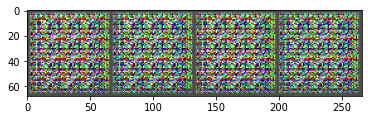

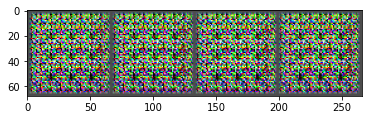

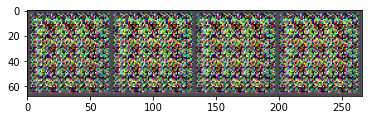

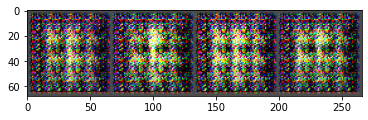

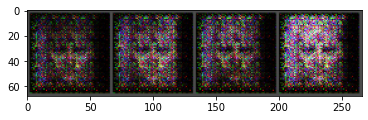

...

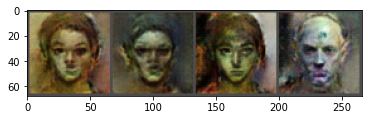

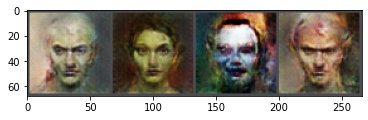

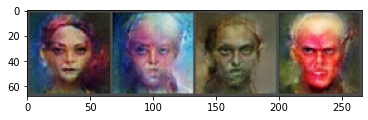

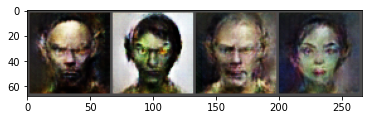

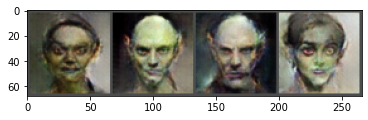

In [ ]:
G = Generator(128)
D = Discriminator(128)
# G.weight_init(mean=0.0, std=0.02)
# D.weight_init(mean=0.0, std=0.02)
G = G.cuda()
D = D.cuda()

# Binary Cross Entropy loss
BCE_loss = nn.BCELoss()

# Adam optimizer
G_optimizer = optim.Adam(G.parameters(), lr=lr, betas=(0.5, 0.999))
D_optimizer = optim.Adam(D.parameters(), lr=lr, betas=(0.5, 0.999))
# Train GAN
collect_x_gen = []
train(your_train_loader)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


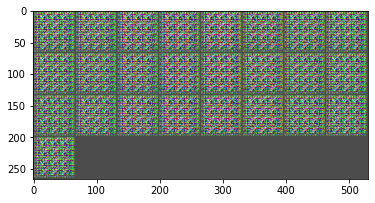

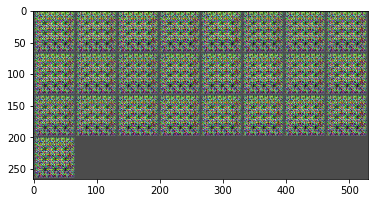

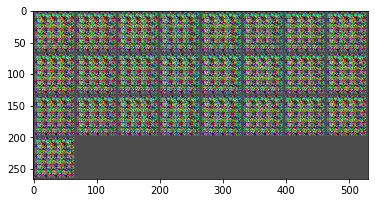

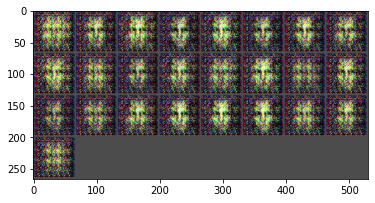

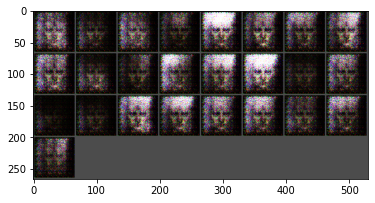

...

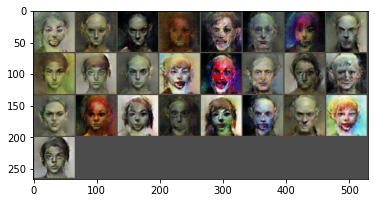

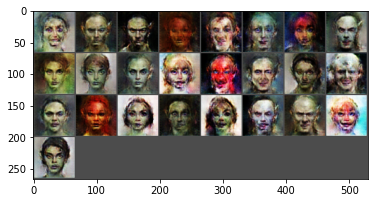

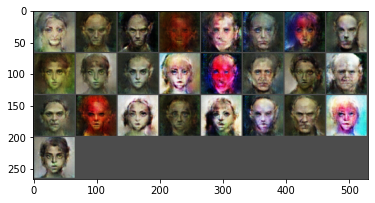

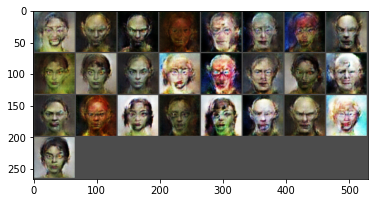

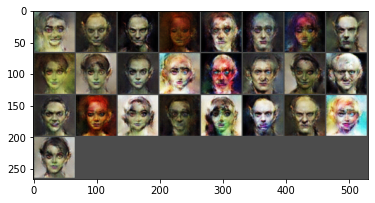

In [ ]:
for x_gen in collect_x_gen:
    show_imgs(x_gen)

# A demo of a state of the art GAN and "painting" with them in your browser:

https://gandissect.csail.mit.edu

By our colleagues at the MIT-IBM Watson AI Lab.


# Where to go from here
* Use a more exciting datasets - check out [the pytorch torchvision.datasets](https://pytorch.org/docs/stable/torchvision/datasets.html) to get started quickly.
* The [original GAN paper](https://papers.nips.cc/paper/5423-generative-adversarial-nets)
* The [DCGAN paper](https://arxiv.org/abs/1511.06434) which made it all work much better for images. Start from: pytorch DCGAN [example](https://github.com/pytorch/examples/blob/master/dcgan/main.py) and [tutorial](https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html)
* Newer generations of loss functions measure different distances between distributions $p_{data}$ and $p_G$. For example [WGAN](https://github.com/martinarjovsky/WassersteinGAN), [WGAN-GP](https://arxiv.org/abs/1704.00028), [Fisher GAN](https://arxiv.org/abs/1705.09675), [Sobolev GAN](https://arxiv.org/abs/1711.04894), many more. They often have better stability properties wrt the original GAN loss.

# References for this tutorial
* pytorch DCGAN [example](https://github.com/pytorch/examples/blob/master/dcgan/main.py) and [tutorial](https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html) by Nathan Inkawhich
* [Medium blog post](https://medium.com/ai-society/gans-from-scratch-1-a-deep-introduction-with-code-in-pytorch-and-tensorflow-cb03cdcdba0f) by Diego Gomez Mosquera
* [Material made for ITDS course at CUNY](https://github.com/grantmlong/itds2019/blob/master/lecture-6/DL_lab_solutions.ipynb) by Tom Sercu (that's me!)
* [Blog post](https://towardsdatascience.com/graduating-in-gans-going-from-understanding-generative-adversarial-networks-to-running-your-own-39804c283399) by Cecelia Shao
* [GAN overview image](https://www.slideshare.net/xavigiro/deep-learning-for-computer-vision-generative-models-and-adversarial-training-upc-2016) from Xavier Giro